## Domain:
Object recognition

## Context:
The purpose is to classify a given silhouette as one of three types of vehicle,using a set of features extracted from the silhouette. The vehicle may be viewed from one of many different angles.

## Objective:
Apply dimensionality reduction technique - PCA and train a model using principal components instead of training the model using just the raw dat and check the difference between raw model and pc used model

## Import Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns
import warnings
warnings.simplefilter('ignore')

## Reading Data

In [2]:
df=pd.read_csv("vehicle-1.csv")

In [3]:
df.head()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
0,95,48.0,83.0,178.0,72.0,10,162.0,42.0,20.0,159,176.0,379.0,184.0,70.0,6.0,16.0,187.0,197,van
1,91,41.0,84.0,141.0,57.0,9,149.0,45.0,19.0,143,170.0,330.0,158.0,72.0,9.0,14.0,189.0,199,van
2,104,50.0,106.0,209.0,66.0,10,207.0,32.0,23.0,158,223.0,635.0,220.0,73.0,14.0,9.0,188.0,196,car
3,93,41.0,82.0,159.0,63.0,9,144.0,46.0,19.0,143,160.0,309.0,127.0,63.0,6.0,10.0,199.0,207,van
4,85,44.0,70.0,205.0,103.0,52,149.0,45.0,19.0,144,241.0,325.0,188.0,127.0,9.0,11.0,180.0,183,bus


## Data Analysis and EDA

In [4]:
df.shape

(846, 19)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 846 entries, 0 to 845
Data columns (total 19 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   compactness                  846 non-null    int64  
 1   circularity                  841 non-null    float64
 2   distance_circularity         842 non-null    float64
 3   radius_ratio                 840 non-null    float64
 4   pr.axis_aspect_ratio         844 non-null    float64
 5   max.length_aspect_ratio      846 non-null    int64  
 6   scatter_ratio                845 non-null    float64
 7   elongatedness                845 non-null    float64
 8   pr.axis_rectangularity       843 non-null    float64
 9   max.length_rectangularity    846 non-null    int64  
 10  scaled_variance              843 non-null    float64
 11  scaled_variance.1            844 non-null    float64
 12  scaled_radius_of_gyration    844 non-null    float64
 13  scaled_radius_of_gyr

In [6]:
df.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
compactness,846.0,NaN,NaN,NaN,93.678487,8.234474,73.0,87.0,93.0,100.0,119.0
circularity,841.0,NaN,NaN,NaN,44.828775,6.152172,33.0,40.0,44.0,49.0,59.0
distance_circularity,842.0,NaN,NaN,NaN,82.110451,15.778292,40.0,70.0,80.0,98.0,112.0
radius_ratio,840.0,NaN,NaN,NaN,168.888095,33.520198,104.0,141.0,167.0,195.0,333.0
pr.axis_aspect_ratio,844.0,NaN,NaN,NaN,61.67891,7.891463,47.0,57.0,61.0,65.0,138.0
max.length_aspect_ratio,846.0,NaN,NaN,NaN,8.567376,4.601217,2.0,7.0,8.0,10.0,55.0
scatter_ratio,845.0,NaN,NaN,NaN,168.901775,33.214848,112.0,147.0,157.0,198.0,265.0
elongatedness,845.0,NaN,NaN,NaN,40.933728,7.816186,26.0,33.0,43.0,46.0,61.0
pr.axis_rectangularity,843.0,NaN,NaN,NaN,20.582444,2.592933,17.0,19.0,20.0,23.0,29.0
max.length_rectangularity,846.0,NaN,NaN,NaN,147.998818,14.515652,118.0,137.0,146.0,159.0,188.0


In [7]:
df.isna().sum()

compactness                    0
circularity                    5
distance_circularity           4
radius_ratio                   6
pr.axis_aspect_ratio           2
max.length_aspect_ratio        0
scatter_ratio                  1
elongatedness                  1
pr.axis_rectangularity         3
max.length_rectangularity      0
scaled_variance                3
scaled_variance.1              2
scaled_radius_of_gyration      2
scaled_radius_of_gyration.1    4
skewness_about                 6
skewness_about.1               1
skewness_about.2               1
hollows_ratio                  0
class                          0
dtype: int64

In [8]:
df.circularity.value_counts(dropna=False)

circularity
43.0    59
45.0    58
44.0    50
46.0    48
38.0    47
42.0    47
40.0    42
39.0    42
37.0    42
36.0    41
54.0    39
47.0    36
41.0    35
55.0    33
48.0    31
53.0    30
51.0    29
49.0    28
52.0    28
35.0    16
50.0    16
56.0    15
57.0    12
34.0     9
NaN      5
58.0     5
33.0     2
59.0     1
Name: count, dtype: int64

In [9]:
df.fillna(0,inplace=True)

In [10]:
df.isna().sum()

compactness                    0
circularity                    0
distance_circularity           0
radius_ratio                   0
pr.axis_aspect_ratio           0
max.length_aspect_ratio        0
scatter_ratio                  0
elongatedness                  0
pr.axis_rectangularity         0
max.length_rectangularity      0
scaled_variance                0
scaled_variance.1              0
scaled_radius_of_gyration      0
scaled_radius_of_gyration.1    0
skewness_about                 0
skewness_about.1               0
skewness_about.2               0
hollows_ratio                  0
class                          0
dtype: int64

In [11]:
df.corr(numeric_only=True)

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio
compactness,1.000000,0.574441,0.745593,0.627670,0.071375,0.148249,0.806336,-0.773421,0.739684,0.676143,0.707625,0.800168,0.578421,-0.178312,0.241174,0.154301,0.207348,0.365552
circularity,0.574441,1.000000,0.660452,0.489599,0.135048,0.231982,0.695547,-0.670666,0.610239,0.812086,0.667998,0.672637,0.775744,0.015752,0.112561,0.018310,0.003347,0.088378
distance_circularity,0.745593,0.660452,1.000000,0.651170,0.136308,0.254460,0.848852,-0.846982,0.759863,0.725324,0.758982,0.823849,0.672074,-0.169302,0.102696,0.258261,0.119608,0.336511
radius_ratio,0.627670,0.489599,0.651170,1.000000,0.562478,0.415929,0.650710,-0.693759,0.581360,0.503446,0.664010,0.628428,0.471496,-0.115621,0.028186,0.168478,0.256055,0.438076
pr.axis_aspect_ratio,0.071375,0.135048,0.136308,0.562478,1.000000,0.608483,0.083544,-0.151618,0.064171,0.100340,0.221047,0.067040,0.103004,0.128483,-0.041170,-0.011896,0.165573,0.250551
max.length_aspect_ratio,0.148249,0.231982,0.254460,0.415929,0.608483,1.000000,0.166794,-0.175109,0.143677,0.305943,0.301331,0.140213,0.189085,0.256970,0.018137,0.042918,-0.004059,0.143919
scatter_ratio,0.806336,0.695547,0.848852,0.650710,0.083544,0.166794,1.000000,-0.952592,0.886931,0.807296,0.886731,0.973876,0.776872,-0.002667,0.082517,0.202246,0.032574,0.121965
elongatedness,-0.773421,-0.670666,-0.846982,-0.693759,-0.151618,-0.175109,-0.952592,1.000000,-0.842414,-0.756085,-0.867566,-0.925181,-0.731602,0.068715,-0.048792,-0.186662,-0.103669,-0.209485
pr.axis_rectangularity,0.739684,0.610239,0.759863,0.581360,0.064171,0.143677,0.886931,-0.842414,1.000000,0.719468,0.794273,0.882315,0.692593,0.001550,0.095738,0.202506,0.013672,0.092981
max.length_rectangularity,0.676143,0.812086,0.725324,0.503446,0.100340,0.305943,0.807296,-0.756085,0.719468,1.000000,0.699795,0.783195,0.842182,0.059980,0.136839,-0.000642,-0.028654,0.076770


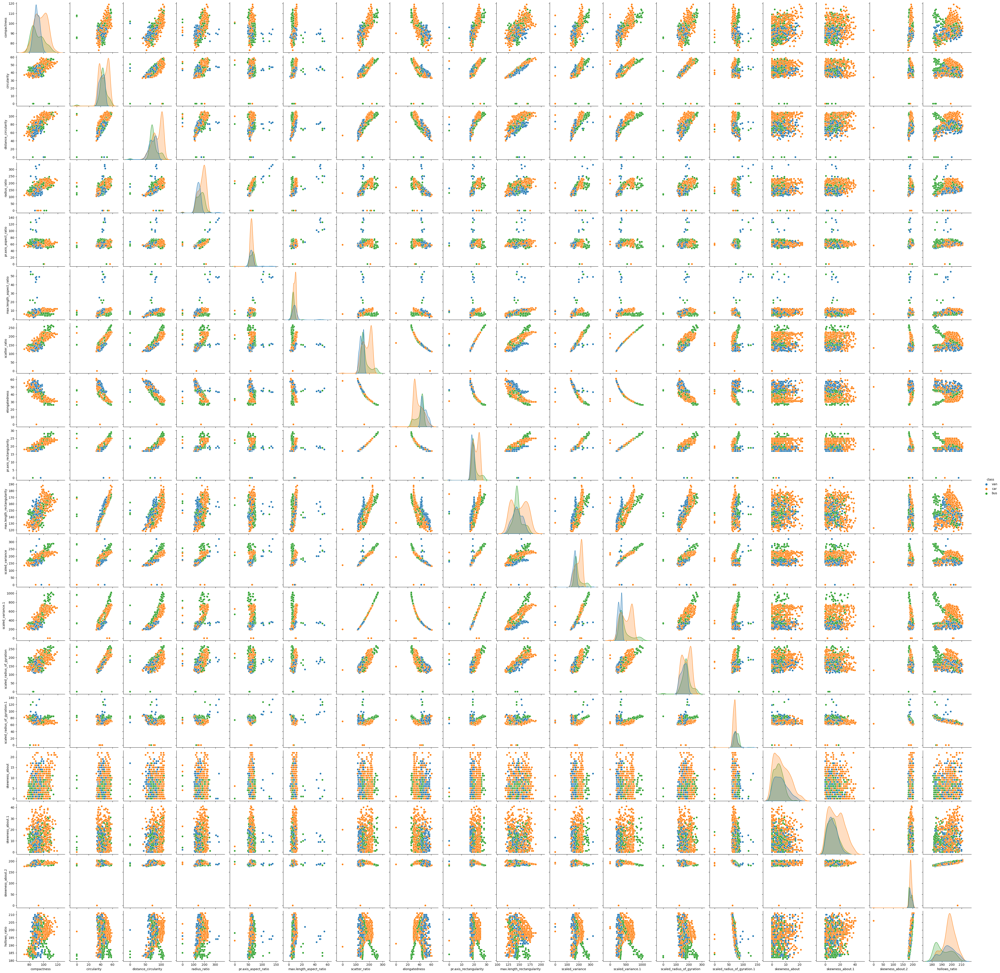

In [12]:
sns.pairplot(df,hue="class")

<Axes: >

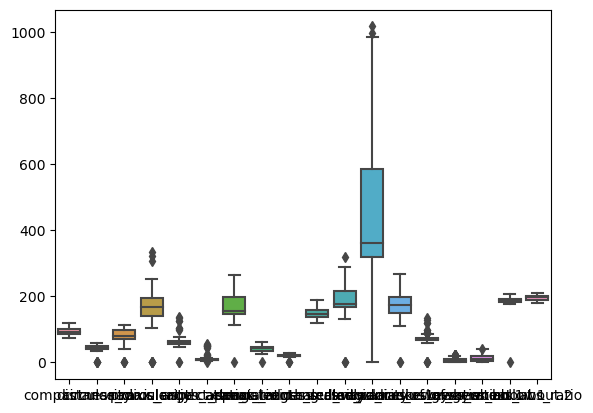

In [13]:
figsize=(20,10)
sns.boxplot(df,width=0.8)

In [14]:
print('displaying outliers in each column\n')

columns = list(df.columns)[:-1]
for cols in columns:
    Q3 = df[cols].quantile(0.75)
    Q1 = df[cols].quantile(0.25)
    IQR = Q3 - Q1
    print("------------------------------------------------------------------------------")
    
    print(f'{cols}')   
    potential_outliers = (df.loc[((df[cols] < (Q1 - 1.5 * IQR)) | (df[cols] > (Q3 + 1.5 * IQR)))])
     
    # Count and display potential outliers
    print(f'Number of rows with outliers: {len(potential_outliers)}')
    display(potential_outliers)

displaying outliers in each column

------------------------------------------------------------------------------
compactness
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
circularity
Number of rows with outliers: 5


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
5,107,0.0,106.0,172.0,50.0,6,255.0,26.0,28.0,169,280.0,957.0,264.0,85.0,5.0,9.0,181.0,183,bus
105,108,0.0,103.0,202.0,64.0,10,220.0,30.0,25.0,168,0.0,711.0,214.0,73.0,11.0,0.0,188.0,199,car
118,85,0.0,0.0,128.0,56.0,8,150.0,46.0,19.0,144,168.0,324.0,173.0,82.0,9.0,14.0,180.0,184,bus
266,86,0.0,65.0,116.0,53.0,6,152.0,45.0,19.0,141,175.0,335.0,0.0,85.0,5.0,4.0,179.0,183,bus
396,108,0.0,106.0,177.0,51.0,5,256.0,26.0,28.0,170,285.0,966.0,261.0,87.0,11.0,2.0,182.0,181,bus


------------------------------------------------------------------------------
distance_circularity
Number of rows with outliers: 4


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
35,100,46.0,0.0,172.0,67.0,9,157.0,43.0,20.0,150,170.0,363.0,184.0,67.0,17.0,7.0,192.0,200,van
118,85,0.0,0.0,128.0,56.0,8,150.0,46.0,19.0,144,168.0,324.0,173.0,82.0,9.0,14.0,180.0,184,bus
207,85,42.0,0.0,121.0,55.0,7,149.0,46.0,19.0,146,167.0,323.0,0.0,85.0,1.0,6.0,179.0,182,bus
319,102,51.0,0.0,194.0,60.0,6,220.0,30.0,25.0,162,247.0,731.0,209.0,80.0,7.0,7.0,188.0,186,bus


------------------------------------------------------------------------------
radius_ratio
Number of rows with outliers: 9


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
9,93,44.0,98.0,0.0,62.0,11,183.0,36.0,22.0,146,202.0,505.0,152.0,64.0,4.0,14.0,195.0,204,car
37,90,48.0,86.0,306.0,126.0,49,153.0,44.0,19.0,156,272.0,346.0,200.0,118.0,0.0,15.0,185.0,194,van
78,104,52.0,94.0,0.0,66.0,5,208.0,31.0,24.0,161,227.0,666.0,218.0,76.0,11.0,4.0,193.0,191,bus
135,89,47.0,83.0,322.0,133.0,48,158.0,43.0,20.0,163,229.0,364.0,176.0,97.0,0.0,14.0,184.0,194,van
159,91,45.0,75.0,0.0,57.0,6,150.0,44.0,19.0,146,170.0,335.0,180.0,66.0,16.0,2.0,193.0,198,car
287,88,43.0,84.0,0.0,55.0,11,154.0,44.0,19.0,150,174.0,350.0,164.0,73.0,6.0,2.0,185.0,196,van
345,101,54.0,106.0,0.0,57.0,7,236.0,28.0,26.0,164,256.0,833.0,253.0,81.0,6.0,14.0,185.0,185,bus
388,94,47.0,85.0,333.0,138.0,49,155.0,43.0,19.0,155,320.0,354.0,187.0,135.0,12.0,9.0,188.0,196,van
467,96,54.0,104.0,0.0,58.0,10,215.0,31.0,24.0,175,221.0,682.0,222.0,75.0,13.0,23.0,186.0,194,car


------------------------------------------------------------------------------
pr.axis_aspect_ratio
Number of rows with outliers: 10


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
4,85,44.0,70.0,205.0,103.0,52,149.0,45.0,19.0,144,241.0,325.0,188.0,127.0,9.0,11.0,180.0,183,bus
19,101,56.0,100.0,215.0,0.0,10,208.0,32.0,24.0,169,227.0,651.0,223.0,74.0,6.0,5.0,186.0,193,car
37,90,48.0,86.0,306.0,126.0,49,153.0,44.0,19.0,156,272.0,346.0,200.0,118.0,0.0,15.0,185.0,194,van
100,82,45.0,66.0,252.0,126.0,52,148.0,45.0,19.0,144,237.0,326.0,185.0,119.0,1.0,1.0,181.0,185,bus
135,89,47.0,83.0,322.0,133.0,48,158.0,43.0,20.0,163,229.0,364.0,176.0,97.0,0.0,14.0,184.0,194,van
222,100,50.0,81.0,197.0,0.0,6,186.0,34.0,22.0,158,206.0,531.0,198.0,74.0,0.0,1.0,197.0,198,bus
291,89,45.0,81.0,246.0,102.0,43,155.0,44.0,20.0,160,200.0,347.0,177.0,90.0,9.0,17.0,183.0,192,van
388,94,47.0,85.0,333.0,138.0,49,155.0,43.0,19.0,155,320.0,354.0,187.0,135.0,12.0,9.0,188.0,196,van
523,90,43.0,81.0,231.0,97.0,46,150.0,45.0,19.0,149,200.0,332.0,164.0,91.0,5.0,9.0,186.0,196,van
706,82,43.0,70.0,250.0,105.0,55,139.0,48.0,18.0,145,231.0,289.0,172.0,99.0,4.0,9.0,190.0,199,van


------------------------------------------------------------------------------
max.length_aspect_ratio
Number of rows with outliers: 13


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
4,85,44.0,70.0,205.0,103.0,52,149.0,45.0,19.0,144,241.0,325.0,188.0,127.0,9.0,11.0,180.0,183,bus
37,90,48.0,86.0,306.0,126.0,49,153.0,44.0,19.0,156,272.0,346.0,200.0,118.0,0.0,15.0,185.0,194,van
100,82,45.0,66.0,252.0,126.0,52,148.0,45.0,19.0,144,237.0,326.0,185.0,119.0,1.0,1.0,181.0,185,bus
127,85,41.0,66.0,155.0,65.0,22,149.0,45.0,19.0,139,173.0,330.0,155.0,75.0,6.0,16.0,184.0,191,bus
135,89,47.0,83.0,322.0,133.0,48,158.0,43.0,20.0,163,229.0,364.0,176.0,97.0,0.0,14.0,184.0,194,van
291,89,45.0,81.0,246.0,102.0,43,155.0,44.0,20.0,160,200.0,347.0,177.0,90.0,9.0,17.0,183.0,192,van
388,94,47.0,85.0,333.0,138.0,49,155.0,43.0,19.0,155,320.0,354.0,187.0,135.0,12.0,9.0,188.0,196,van
391,91,38.0,70.0,160.0,66.0,25,140.0,47.0,18.0,139,162.0,296.0,130.0,67.0,4.0,11.0,192.0,202,van
523,90,43.0,81.0,231.0,97.0,46,150.0,45.0,19.0,149,200.0,332.0,164.0,91.0,5.0,9.0,186.0,196,van
544,88,43.0,70.0,177.0,74.0,19,152.0,44.0,19.0,143,180.0,342.0,168.0,76.0,1.0,9.0,186.0,189,bus


------------------------------------------------------------------------------
scatter_ratio
Number of rows with outliers: 1


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
249,85,34.0,53.0,127.0,58.0,6,0.0,58.0,17.0,121,137.0,197.0,127.0,70.0,0.0,20.0,185.0,189,car


------------------------------------------------------------------------------
elongatedness
Number of rows with outliers: 1


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
215,90,39.0,86.0,169.0,62.0,7,162.0,0.0,20.0,131,194.0,388.0,147.0,74.0,1.0,22.0,185.0,191,car


------------------------------------------------------------------------------
pr.axis_rectangularity
Number of rows with outliers: 3


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
70,96,55.0,98.0,161.0,54.0,10,215.0,31.0,0.0,175,226.0,683.0,221.0,76.0,3.0,6.0,185.0,193,car
237,85,45.0,65.0,128.0,56.0,8,151.0,45.0,0.0,145,170.0,332.0,186.0,81.0,1.0,10.0,179.0,184,bus
273,96,45.0,80.0,162.0,63.0,9,146.0,46.0,0.0,148,161.0,316.0,161.0,64.0,5.0,10.0,199.0,207,van


------------------------------------------------------------------------------
max.length_rectangularity
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
scaled_variance
Number of rows with outliers: 4


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
105,108,0.0,103.0,202.0,64.0,10,220.0,30.0,25.0,168,0.0,711.0,214.0,73.0,11.0,0.0,188.0,199,car
372,97,47.0,87.0,164.0,64.0,9,156.0,43.0,20.0,149,0.0,359.0,182.0,68.0,1.0,13.0,192.0,202,van
388,94,47.0,85.0,333.0,138.0,49,155.0,43.0,19.0,155,320.0,354.0,187.0,135.0,12.0,9.0,188.0,196,van
522,89,36.0,69.0,162.0,63.0,6,140.0,48.0,18.0,131,0.0,291.0,126.0,66.0,1.0,38.0,193.0,204,car


------------------------------------------------------------------------------
scaled_variance.1
Number of rows with outliers: 2


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
85,110,58.0,106.0,180.0,51.0,6,261.0,26.0,28.0,171,278.0,998.0,257.0,83.0,9.0,13.0,181.0,182,bus
835,111,58.0,105.0,183.0,51.0,6,265.0,26.0,29.0,174,285.0,1018.0,255.0,85.0,4.0,8.0,181.0,183,bus


------------------------------------------------------------------------------
scaled_radius_of_gyration
Number of rows with outliers: 2


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
207,85,42.0,0.0,121.0,55.0,7,149.0,46.0,19.0,146,167.0,323.0,0.0,85.0,1.0,6.0,179.0,182,bus
266,86,0.0,65.0,116.0,53.0,6,152.0,45.0,19.0,141,175.0,335.0,0.0,85.0,5.0,4.0,179.0,183,bus


------------------------------------------------------------------------------
scaled_radius_of_gyration.1
Number of rows with outliers: 19


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
4,85,44.0,70.0,205.0,103.0,52,149.0,45.0,19.0,144,241.0,325.0,188.0,127.0,9.0,11.0,180.0,183,bus
37,90,48.0,86.0,306.0,126.0,49,153.0,44.0,19.0,156,272.0,346.0,200.0,118.0,0.0,15.0,185.0,194,van
47,85,42.0,66.0,122.0,54.0,6,148.0,46.0,19.0,141,172.0,317.0,174.0,88.0,6.0,14.0,180.0,182,bus
66,81,43.0,68.0,125.0,57.0,8,149.0,46.0,19.0,146,169.0,323.0,172.0,0.0,0.0,18.0,179.0,184,bus
77,86,40.0,62.0,140.0,62.0,7,150.0,45.0,19.0,133,165.0,330.0,173.0,0.0,2.0,3.0,180.0,185,car
79,89,44.0,68.0,113.0,50.0,7,150.0,45.0,19.0,147,171.0,328.0,189.0,88.0,6.0,5.0,179.0,182,bus
100,82,45.0,66.0,252.0,126.0,52,148.0,45.0,19.0,144,237.0,326.0,185.0,119.0,1.0,1.0,181.0,185,bus
135,89,47.0,83.0,322.0,133.0,48,158.0,43.0,20.0,163,229.0,364.0,176.0,97.0,0.0,14.0,184.0,194,van
192,93,43.0,76.0,149.0,57.0,7,149.0,44.0,19.0,143,172.0,335.0,176.0,0.0,14.0,0.0,189.0,194,car
230,85,35.0,47.0,110.0,55.0,3,117.0,57.0,17.0,122,136.0,203.0,139.0,89.0,5.0,9.0,180.0,184,van


------------------------------------------------------------------------------
skewness_about
Number of rows with outliers: 12


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
44,119,54.0,106.0,220.0,65.0,12,213.0,31.0,24.0,167,223.0,675.0,232.0,66.0,20.0,1.0,192.0,202,car
113,88,35.0,50.0,121.0,58.0,5,114.0,59.0,17.0,122,132.0,192.0,138.0,74.0,21.0,4.0,182.0,187,car
123,90,36.0,57.0,130.0,57.0,6,121.0,56.0,17.0,127,137.0,216.0,132.0,68.0,22.0,23.0,190.0,195,car
190,97,48.0,94.0,198.0,63.0,9,181.0,36.0,21.0,155,200.0,494.0,189.0,64.0,20.0,11.0,199.0,203,car
346,117,52.0,110.0,228.0,65.0,12,212.0,31.0,24.0,163,228.0,668.0,220.0,66.0,21.0,25.0,194.0,205,car
400,107,53.0,108.0,213.0,64.0,12,206.0,32.0,23.0,163,216.0,627.0,202.0,65.0,21.0,22.0,194.0,205,car
505,115,53.0,100.0,205.0,64.0,11,220.0,30.0,25.0,166,229.0,710.0,214.0,71.0,21.0,11.0,189.0,199,car
516,92,42.0,75.0,172.0,60.0,8,147.0,45.0,19.0,142,174.0,322.0,160.0,62.0,22.0,10.0,206.0,211,car
623,106,52.0,108.0,207.0,64.0,12,221.0,31.0,25.0,168,229.0,709.0,200.0,73.0,22.0,38.0,190.0,205,car
761,115,51.0,100.0,201.0,60.0,12,196.0,34.0,23.0,162,207.0,573.0,184.0,62.0,22.0,1.0,198.0,208,car


------------------------------------------------------------------------------
skewness_about.1
Number of rows with outliers: 1


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
132,97,42.0,101.0,186.0,59.0,9,186.0,36.0,22.0,138,208.0,511.0,168.0,67.0,7.0,41.0,194.0,206,car


------------------------------------------------------------------------------
skewness_about.2
Number of rows with outliers: 1


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
419,93,34.0,72.0,144.0,56.0,6,133.0,50.0,18.0,123,158.0,263.0,125.0,63.0,5.0,20.0,0.0,206,car


------------------------------------------------------------------------------
hollows_ratio
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


In [15]:
#correct code

import math
columns = list(df.columns)[:-1]
for cols in columns:
    Q3 = df[cols].quantile(0.75)
    Q1 = df[cols].quantile(0.25)
    IQR = Q3 - Q1
    print(df[cols].median())
    #df.loc[((df[cols] < (Q1 - 1.5 * IQR)) | (df[cols] > (Q3 + 1.5 * IQR)))]=(df[cols].median())
    
    outliers_mask = (df[cols] < (Q1 - 1.5 * IQR)) | (df[cols] > (Q3 + 1.5 * IQR))
    #print(outliers_mask)
    # Replace potential outliers with the median of the column
    df.loc[outliers_mask, cols] = df[cols].median()
#print(df.loc[4])

93.0
44.0
80.0
166.5
61.0
8.0
157.0
43.0
20.0
146.0
178.0
363.0
173.0
71.0
5.0
11.0
188.0
197.0


In [16]:
print('displaying outliers in each column\n')

columns = list(df.columns)[:-1]
for cols in columns:
    Q3 = df[cols].quantile(0.75)
    Q1 = df[cols].quantile(0.25)
    IQR = Q3 - Q1
    print("------------------------------------------------------------------------------")
    
    print(f'{cols}')   
    potential_outliers = (df.loc[((df[cols] < (Q1 - 1.5 * IQR)) | (df[cols] > (Q3 + 1.5 * IQR)))])
     
    # Count and display potential outliers
    print(f'Number of rows with outliers: {len(potential_outliers)}')
    display(potential_outliers)

displaying outliers in each column

------------------------------------------------------------------------------
compactness
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
circularity
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
distance_circularity
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
radius_ratio
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
pr.axis_aspect_ratio
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
max.length_aspect_ratio
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
scatter_ratio
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
elongatedness
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
pr.axis_rectangularity
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
max.length_rectangularity
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
scaled_variance
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
scaled_variance.1
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
scaled_radius_of_gyration
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
scaled_radius_of_gyration.1
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
skewness_about
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
skewness_about.1
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
skewness_about.2
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


------------------------------------------------------------------------------
hollows_ratio
Number of rows with outliers: 0


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


we have worked out with the outliers we might have 0s in the dataset so we will resolve this issue by seprating it based on class and fill 0 with median of the resp row

In [17]:
df['class'].unique()

array(['van', 'car', 'bus'], dtype=object)

In [18]:
data_van=df[df['class']=='van']
data_car=df[df['class']=='car']
data_bus=df[df['class']=='bus']

data_van_copy = data_van.copy(deep = True)
data_car_copy = data_car.copy(deep = True)
data_bus_copy = data_bus.copy(deep = True)

data_van.pop('class')
data_car.pop('class')
data_bus.pop('class')

4      bus
5      bus
6      bus
12     bus
14     bus
      ... 
814    bus
815    bus
830    bus
831    bus
835    bus
Name: class, Length: 218, dtype: object

In [19]:
print(data_van.shape)
print(data_car.shape)
print(data_bus.shape)

(199, 18)
(429, 18)
(218, 18)


In [20]:
df[(df == 0).any(axis=1)]

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
20,84,47.0,75.0,153.0,64.0,6,154.0,43.0,19.0,145,175.0,354.0,184.0,75.0,0.0,3.0,185.0,192,bus
24,99,53.0,105.0,219.0,66.0,11,204.0,32.0,23.0,165,221.0,623.0,224.0,68.0,0.0,6.0,191.0,201,car
37,90,48.0,86.0,166.5,61.0,8,153.0,44.0,19.0,156,272.0,346.0,200.0,71.0,0.0,15.0,185.0,194,van
39,81,45.0,68.0,169.0,73.0,6,151.0,44.0,19.0,146,173.0,336.0,186.0,75.0,7.0,0.0,183.0,189,bus
49,91,45.0,79.0,176.0,59.0,9,163.0,40.0,20.0,148,184.0,404.0,179.0,62.0,0.0,10.0,199.0,208,car
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
820,87,38.0,71.0,123.0,53.0,8,137.0,49.0,18.0,127,158.0,277.0,145.0,75.0,0.0,9.0,181.0,186,car
825,86,39.0,84.0,149.0,57.0,8,156.0,43.0,20.0,133,185.0,358.0,157.0,74.0,0.0,23.0,183.0,190,car
826,95,49.0,92.0,193.0,62.0,10,178.0,37.0,21.0,154,200.0,478.0,171.0,64.0,2.0,0.0,198.0,206,car
830,97,37.0,70.0,173.0,66.0,7,151.0,43.0,19.0,129,167.0,346.0,119.0,65.0,0.0,16.0,201.0,208,bus


In [21]:
for col in data_van:
    q1=data_van[col].median()
    data_van[col].replace(0,q1,inplace=True)
    
for column in data_car:
    q1 = data_car[column].median()
    data_car[column].replace( 0, q1, inplace=True)

for column in data_bus:
    q1 = data_bus[column].median()
    data_bus[column].replace( 0, q1, inplace=True)

In [22]:
# i think this is not needed but here he is not using if loop inside above loops if we use if col.dtype !=object then this nonsense is not needed
f_van = data_van.join(pd.DataFrame(data_van_copy['class']))

f_car = data_car.join(pd.DataFrame(data_car_copy['class']))
f_bus = data_bus.join(pd.DataFrame(data_bus_copy['class']))

In [23]:
data_df = pd.concat([f_bus,f_car,f_van])

In [24]:
data_df.head()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
4,85,44.0,70.0,205.0,61.0,8,149.0,45.0,19.0,144,241.0,325.0,188.0,71.0,9.0,11.0,180.0,183,bus
5,107,44.0,106.0,172.0,50.0,6,255.0,26.0,28.0,169,280.0,957.0,264.0,85.0,5.0,9.0,181.0,183,bus
6,97,43.0,73.0,173.0,65.0,6,153.0,42.0,19.0,143,176.0,361.0,172.0,66.0,13.0,1.0,200.0,204,bus
12,88,46.0,74.0,171.0,68.0,6,152.0,43.0,19.0,148,180.0,349.0,192.0,71.0,5.0,11.0,189.0,195,bus
14,94,49.0,79.0,203.0,71.0,5,174.0,37.0,21.0,154,196.0,465.0,206.0,71.0,6.0,2.0,197.0,199,bus


In [25]:
data_df.shape

(846, 19)

In [26]:
df[(df == 0).any(axis=1)]

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
20,84,47.0,75.0,153.0,64.0,6,154.0,43.0,19.0,145,175.0,354.0,184.0,75.0,0.0,3.0,185.0,192,bus
24,99,53.0,105.0,219.0,66.0,11,204.0,32.0,23.0,165,221.0,623.0,224.0,68.0,0.0,6.0,191.0,201,car
37,90,48.0,86.0,166.5,61.0,8,153.0,44.0,19.0,156,272.0,346.0,200.0,71.0,0.0,15.0,185.0,194,van
39,81,45.0,68.0,169.0,73.0,6,151.0,44.0,19.0,146,173.0,336.0,186.0,75.0,7.0,0.0,183.0,189,bus
49,91,45.0,79.0,176.0,59.0,9,163.0,40.0,20.0,148,184.0,404.0,179.0,62.0,0.0,10.0,199.0,208,car
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
820,87,38.0,71.0,123.0,53.0,8,137.0,49.0,18.0,127,158.0,277.0,145.0,75.0,0.0,9.0,181.0,186,car
825,86,39.0,84.0,149.0,57.0,8,156.0,43.0,20.0,133,185.0,358.0,157.0,74.0,0.0,23.0,183.0,190,car
826,95,49.0,92.0,193.0,62.0,10,178.0,37.0,21.0,154,200.0,478.0,171.0,64.0,2.0,0.0,198.0,206,car
830,97,37.0,70.0,173.0,66.0,7,151.0,43.0,19.0,129,167.0,346.0,119.0,65.0,0.0,16.0,201.0,208,bus


In [27]:
data_df.duplicated().sum()

0

In [28]:
data_df.corr(numeric_only=True)

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio
compactness,1.000000,0.684887,0.789928,0.721913,0.192864,0.499928,0.812620,-0.788750,0.813694,0.676143,0.769771,0.809521,0.585278,-0.245348,0.212352,0.149894,0.298537,0.365552
circularity,0.684887,1.000000,0.792320,0.638183,0.203253,0.560470,0.847938,-0.821472,0.843400,0.961318,0.802762,0.830121,0.925825,0.069274,0.147027,-0.010895,-0.104426,0.046351
distance_circularity,0.789928,0.792320,1.000000,0.794127,0.244332,0.666809,0.905076,-0.911307,0.893025,0.774527,0.869504,0.886087,0.705792,-0.228050,0.131006,0.258791,0.146098,0.332732
radius_ratio,0.721913,0.638183,0.794127,1.000000,0.650589,0.463946,0.769884,-0.825328,0.744085,0.579357,0.785975,0.762827,0.550723,-0.390434,0.057676,0.178481,0.405865,0.491776
pr.axis_aspect_ratio,0.192864,0.203253,0.244332,0.650589,1.000000,0.150295,0.194195,-0.298144,0.163047,0.147592,0.207040,0.197250,0.148637,-0.320441,-0.055454,-0.012515,0.400882,0.415734
max.length_aspect_ratio,0.499928,0.560470,0.666809,0.463946,0.150295,1.000000,0.490759,-0.504181,0.487931,0.642713,0.401362,0.465569,0.397425,-0.334341,0.107196,0.139007,0.083794,0.413174
scatter_ratio,0.812620,0.847938,0.905076,0.769884,0.194195,0.490759,1.000000,-0.971601,0.989751,0.809083,0.960841,0.982520,0.799893,0.012295,0.085855,0.206647,0.005628,0.118817
elongatedness,-0.788750,-0.821472,-0.911307,-0.825328,-0.298144,-0.504181,-0.971601,1.000000,-0.948996,-0.775854,-0.947599,-0.951005,-0.766334,0.077278,-0.069216,-0.181660,-0.115126,-0.216905
pr.axis_rectangularity,0.813694,0.843400,0.893025,0.744085,0.163047,0.487931,0.989751,-0.948996,1.000000,0.810934,0.947288,0.975462,0.796711,0.028505,0.093573,0.208107,-0.018649,0.099286
max.length_rectangularity,0.676143,0.961318,0.774527,0.579357,0.147592,0.642713,0.809083,-0.775854,0.810934,1.000000,0.750156,0.792039,0.866460,0.054341,0.140737,-0.000134,-0.103948,0.076770


<Axes: >

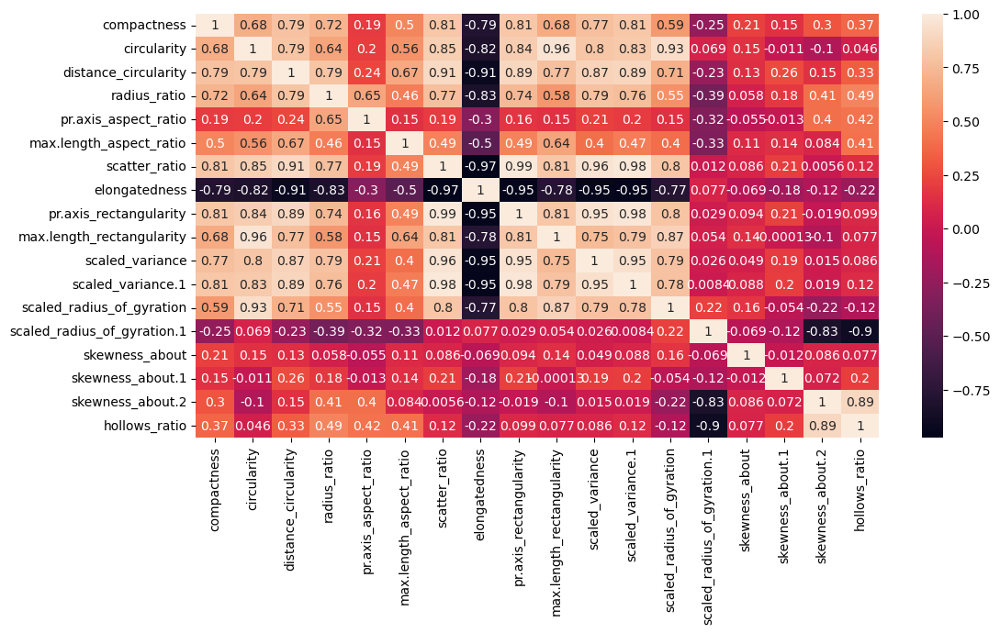

In [29]:
plt.figure(figsize=(12,6))
sns.heatmap(data_df.corr(numeric_only=True), annot=True)

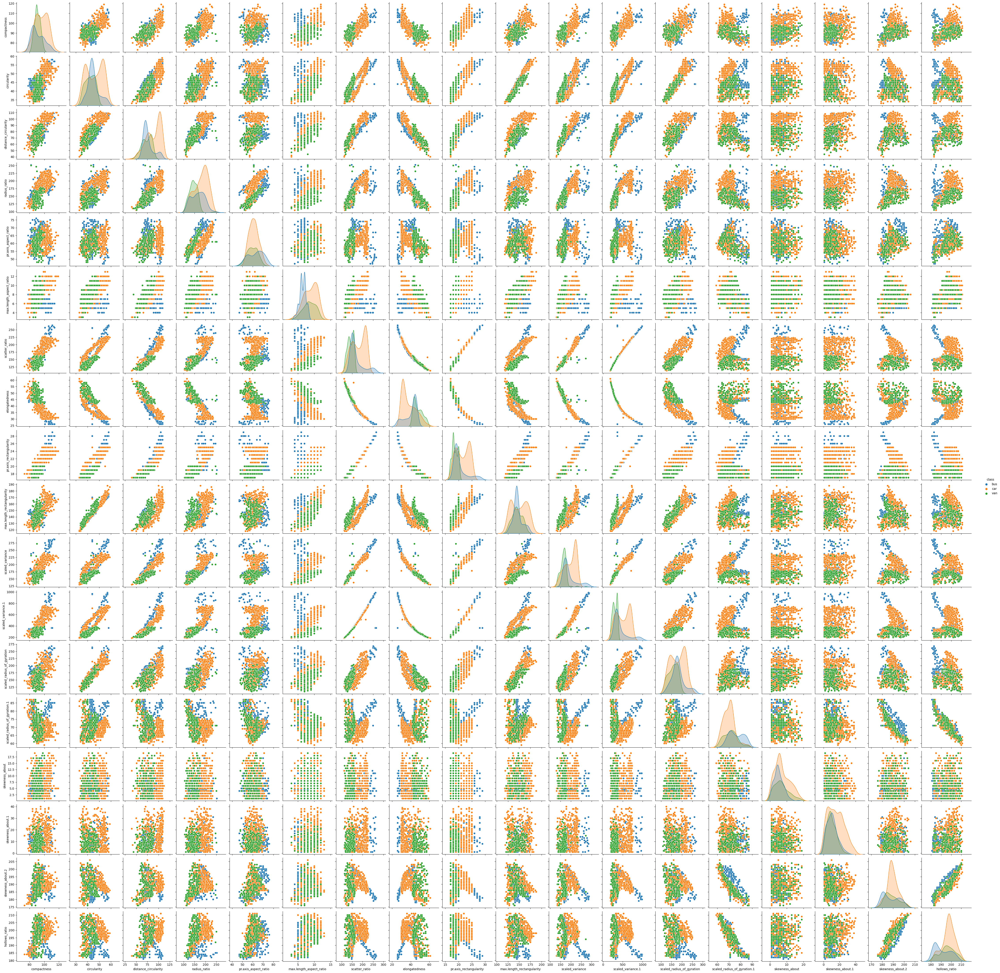

In [30]:
sns.pairplot(data_df, diag_kind='kde', hue = 'class')  #pairplot
plt.show()

<Axes: >

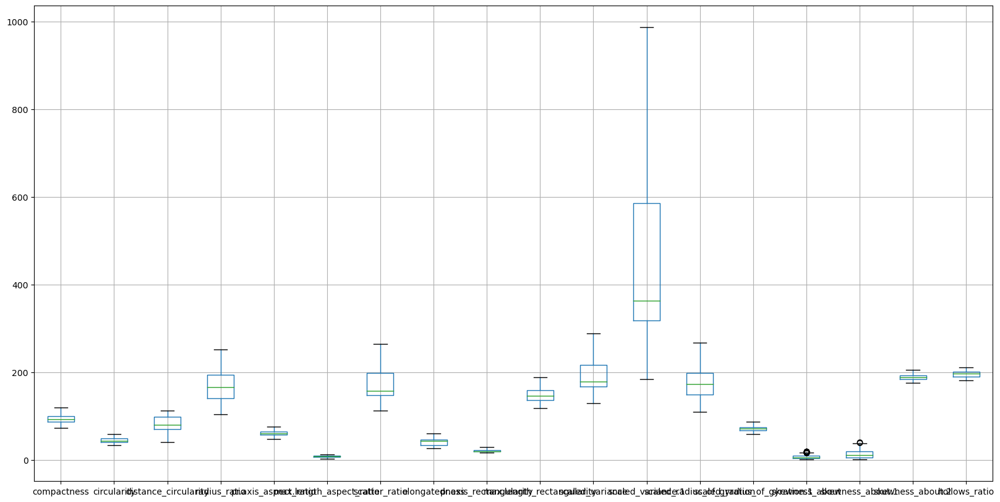

In [31]:
data_df.boxplot(figsize=(20,10))

# This following code for pca is written to learn about the math we can directly call pca also.

In [32]:
X = data_df.drop('class',axis=1)  # The last column index is -1 and that is not considered in the range
y = data_df["class"]

In [33]:
X.pop('pr.axis_aspect_ratio')
X.pop('skewness_about.1')


4      11.0
5       9.0
6       1.0
12     11.0
14      2.0
       ... 
836    12.0
838    23.0
839     4.0
842    20.0
845    18.0
Name: skewness_about.1, Length: 846, dtype: float64

In [34]:
from sklearn.model_selection import train_test_split

x_train,x_test,y_train,y_test=train_test_split(X,y,test_size=0.3,random_state=1)

In [35]:
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(592, 16)
(254, 16)
(592,)
(254,)


In [36]:
from sklearn.preprocessing import StandardScaler

sc=StandardScaler()
x_train_std=sc.fit_transform(x_train)
x_test_std=sc.transform(x_test)



In [37]:
print(len(np.cov(x_train_std)))
# see the len difference we are getting 592 and 16 
# this cov is for 592 rows amongst each other

592


In [38]:
print(len(np.cov(x_train_std.T)))
# this cov is for 16 cols which are converted into rows using T and cov is between wach other

16


In [39]:

np.cov(x_train_std.T)



array([[ 1.00169205,  0.69756094,  0.80118264,  0.72619081,  0.52443081,
         0.82288414, -0.79908369,  0.82337381,  0.69104814,  0.7751604 ,
         0.81654045,  0.61123245, -0.22893094,  0.25634767,  0.28633893,
         0.35506578],
       [ 0.69756094,  1.00169205,  0.78367265,  0.63105173,  0.57195293,
         0.84461725, -0.81730161,  0.84377336,  0.96136736,  0.79878965,
         0.82442432,  0.92721255,  0.07693153,  0.17832715, -0.10878452,
         0.03708658],
       [ 0.80118264,  0.78367265,  1.00169205,  0.79237089,  0.67700945,
         0.90523208, -0.91403179,  0.89482353,  0.76892255,  0.87033529,
         0.8853215 ,  0.70838172, -0.23602737,  0.17745437,  0.16284454,
         0.34412326],
       [ 0.72619081,  0.63105173,  0.79237089,  1.00169205,  0.490912  ,
         0.75939383, -0.81927335,  0.73374226,  0.57417459,  0.7754026 ,
         0.75400833,  0.55058242, -0.39527757,  0.11156327,  0.42033002,
         0.50039808],
       [ 0.52443081,  0.57195293,  0

<Axes: >

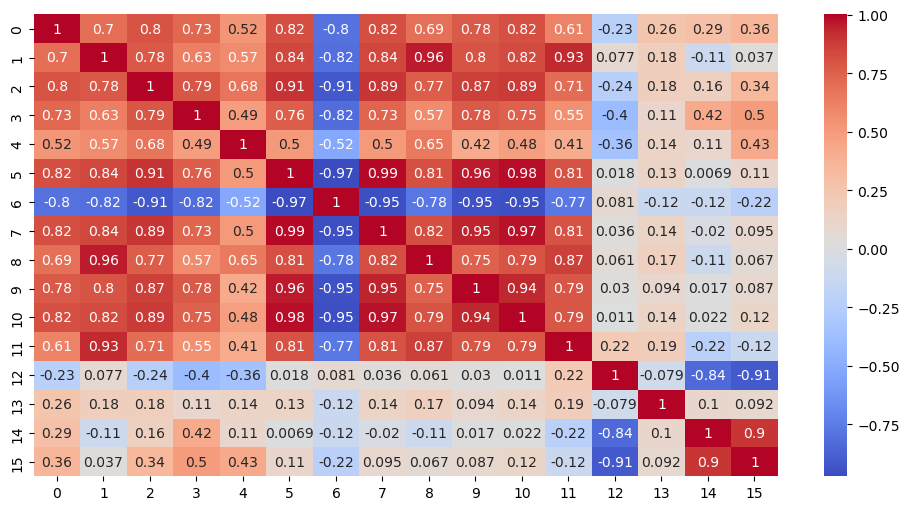

In [40]:
plt.figure(figsize=(12,6))
sns.heatmap(np.cov(x_train_std.T),annot=True,cmap='coolwarm')

## lets find the eigen values and eigen vectors using np

In [41]:
# we are passing cov of the transposed cols since pca is for dim reduction i.e. reducing no. of variables
eigen_values,eigen_vectors=np.linalg.eig(np.cov(x_train_std.T))

In [42]:
#  eigen values are avg of the distances of all the data points from the PC
# op -> [avg dist from pc1, pc2, pc3 ...]
# the eigen values represent how much of the variance can be explained
# Eigenvalues represent variance: Each eigenvalue represents the amount of variance captured by its corresponding principal component. 
# Larger eigenvalues indicate more variance.
eigen_values

array([9.68089605e+00, 3.18054449e+00, 1.02197955e+00, 8.44645915e-01,
       4.07712782e-01, 2.72733474e-01, 1.69808489e-01, 1.24247208e-01,
       8.05940766e-02, 5.14874359e-03, 2.11575771e-02, 2.36606186e-02,
       3.26863878e-02, 4.07532700e-02, 6.34671358e-02, 5.70369871e-02])

In [43]:
# eigen vectors are nothing but unit vectors towards the PC
# these values point to the tip of the unti vectors
# eigen vectors are linear compbinaion of the varibales i.e. PC1= x1 var1 + x2 var2 + ..
# x1 x2 ...  are constant var1 var2 ..  are columns 
eigen_vectors

array([[ 0.27710147,  0.10165753, -0.0595415 , -0.15827411,  0.13460751,
        -0.73969235, -0.41934608, -0.31144754, -0.12886129, -0.00985262,
        -0.13186256, -0.04647793,  0.06914657, -0.0568805 , -0.04343307,
         0.00408269],
       [ 0.28927645, -0.12567944, -0.11544708,  0.1965377 , -0.43066989,
        -0.02300014, -0.02522537,  0.01107538,  0.18825467, -0.05249209,
         0.33932248, -0.64790298,  0.16137684, -0.19383336, -0.15834174,
        -0.00222559],
       [ 0.30289976,  0.06881344,  0.01319676,  0.05967857,  0.25576491,
         0.15871953,  0.27722446, -0.20855988, -0.31136725, -0.00487465,
         0.06674042,  0.05173777, -0.20171883, -0.12788964, -0.70309723,
         0.18255461],
       [ 0.26378179,  0.19516917,  0.15286829, -0.15293935, -0.07354198,
         0.50104831, -0.72413446,  0.01731396,  0.13554229,  0.01168021,
         0.02943882,  0.12932783, -0.02403781,  0.01997797, -0.09019995,
         0.13866235],
       [ 0.20123953,  0.14262032, -0

In [44]:
# we are creating a pair of eigen values and eigen vectors and sorting it  based on eigen values so that we can use appropriate eigen vectors
# if we sort it without making a pair then the maping between eigen vales and eigen vectors will be lost
train_eig_pairs=[(eigen_values[i],eigen_vectors[i]) for i in range(len(eigen_values))]

In [45]:
train_eig_pairs

[(9.680896046813855,
  array([ 0.27710147,  0.10165753, -0.0595415 , -0.15827411,  0.13460751,
         -0.73969235, -0.41934608, -0.31144754, -0.12886129, -0.00985262,
         -0.13186256, -0.04647793,  0.06914657, -0.0568805 , -0.04343307,
          0.00408269])),
 (3.1805444926644717,
  array([ 0.28927645, -0.12567944, -0.11544708,  0.1965377 , -0.43066989,
         -0.02300014, -0.02522537,  0.01107538,  0.18825467, -0.05249209,
          0.33932248, -0.64790298,  0.16137684, -0.19383336, -0.15834174,
         -0.00222559])),
 (1.0219795541423646,
  array([ 0.30289976,  0.06881344,  0.01319676,  0.05967857,  0.25576491,
          0.15871953,  0.27722446, -0.20855988, -0.31136725, -0.00487465,
          0.06674042,  0.05173777, -0.20171883, -0.12788964, -0.70309723,
          0.18255461])),
 (0.8446459151093916,
  array([ 0.26378179,  0.19516917,  0.15286829, -0.15293935, -0.07354198,
          0.50104831, -0.72413446,  0.01731396,  0.13554229,  0.01168021,
          0.02943882,  0

In [46]:
train_eig_pairs.sort(reverse=True)

In [47]:
train_eig_pairs

[(9.680896046813855,
  array([ 0.27710147,  0.10165753, -0.0595415 , -0.15827411,  0.13460751,
         -0.73969235, -0.41934608, -0.31144754, -0.12886129, -0.00985262,
         -0.13186256, -0.04647793,  0.06914657, -0.0568805 , -0.04343307,
          0.00408269])),
 (3.1805444926644717,
  array([ 0.28927645, -0.12567944, -0.11544708,  0.1965377 , -0.43066989,
         -0.02300014, -0.02522537,  0.01107538,  0.18825467, -0.05249209,
          0.33932248, -0.64790298,  0.16137684, -0.19383336, -0.15834174,
         -0.00222559])),
 (1.0219795541423646,
  array([ 0.30289976,  0.06881344,  0.01319676,  0.05967857,  0.25576491,
          0.15871953,  0.27722446, -0.20855988, -0.31136725, -0.00487465,
          0.06674042,  0.05173777, -0.20171883, -0.12788964, -0.70309723,
          0.18255461])),
 (0.8446459151093916,
  array([ 0.26378179,  0.19516917,  0.15286829, -0.15293935, -0.07354198,
          0.50104831, -0.72413446,  0.01731396,  0.13554229,  0.01168021,
          0.02943882,  0

In [48]:
# eigen values and vectors are paired and sorted now lets seprate thoes data

In [49]:
train_eigvalues_sorted = [train_eig_pairs[index][0] for index in range(len(eigen_values))]
train_eigvectors_sorted = [train_eig_pairs[index][1] for index in range(len(eigen_values))]

In [50]:
train_eigvalues_sorted

[9.680896046813855,
 3.1805444926644717,
 1.0219795541423646,
 0.8446459151093916,
 0.40771278193996713,
 0.2727334737561434,
 0.16980848856489478,
 0.12424720831425906,
 0.0805940766263007,
 0.06346713584546813,
 0.05703698714687141,
 0.04075327004494417,
 0.03268638777256791,
 0.02366061858803474,
 0.021157577118493615,
 0.005148743589206065]

In [51]:
train_eigvectors_sorted

[array([ 0.27710147,  0.10165753, -0.0595415 , -0.15827411,  0.13460751,
        -0.73969235, -0.41934608, -0.31144754, -0.12886129, -0.00985262,
        -0.13186256, -0.04647793,  0.06914657, -0.0568805 , -0.04343307,
         0.00408269]),
 array([ 0.28927645, -0.12567944, -0.11544708,  0.1965377 , -0.43066989,
        -0.02300014, -0.02522537,  0.01107538,  0.18825467, -0.05249209,
         0.33932248, -0.64790298,  0.16137684, -0.19383336, -0.15834174,
        -0.00222559]),
 array([ 0.30289976,  0.06881344,  0.01319676,  0.05967857,  0.25576491,
         0.15871953,  0.27722446, -0.20855988, -0.31136725, -0.00487465,
         0.06674042,  0.05173777, -0.20171883, -0.12788964, -0.70309723,
         0.18255461]),
 array([ 0.26378179,  0.19516917,  0.15286829, -0.15293935, -0.07354198,
         0.50104831, -0.72413446,  0.01731396,  0.13554229,  0.01168021,
         0.02943882,  0.12932783, -0.02403781,  0.01997797, -0.09019995,
         0.13866235]),
 array([ 0.20123953,  0.14262032

In [52]:
# Sum of eigenvalues: The sum of all eigenvalues corresponds to the total variance in the original dataset.
# the total variance in your original dataset is 16.027. It doesn't represent a percentage or a proportion but rather an absolute measure of variance.
tot = sum(eigen_values)
tot


16.027072758037235

In [53]:
# Variance is a measure of how spread out the values in a dataset are
# vaiance Example : Suppose you have a class of students, and their ages are 5, 12, 8, 15, 6. The ages are quite spread out, and the variance is high because the ages vary a lot from each other.--> High Variance
# another class of students with ages 10, 11, 9, 10, 10. Here, the ages are close to each other, and the variance is low because the ages are not spread out much.--> low Variance
# standard deviation gives you a sense of how much individual data points tend to vary from the mean. It's a useful measure for understanding the distribution of data. If you have a low standard deviation, it often indicates that the data points are clustered around the mean. If you have a high standard deviation, the data points are more spread out.



# Explained variance is the fraction of the total variance that a principal component represents.
# explained variance helps you understand how much information each principal component carries
var_explained = [(i / tot) for i in train_eigvalues_sorted] 
var_explained
#print(len(var_explained))

[0.6040339488668691,
 0.19844824695573285,
 0.06376582733299589,
 0.05270119677255596,
 0.025439004869776228,
 0.017017048457546518,
 0.010595103118861143,
 0.007752333204574225,
 0.0050286211239594265,
 0.00395999549035807,
 0.003558790055299935,
 0.002542776878860007,
 0.0020394483924818015,
 0.001476290707931643,
 0.0013201148729972253,
 0.00032125289919982924]

In [54]:
# cummulative sum is the sum of all the previous data

cum_var_exp = np.cumsum(var_explained)  
cum_var_exp

array([0.60403395, 0.8024822 , 0.86624802, 0.91894922, 0.94438822,
       0.96140527, 0.97200038, 0.97975271, 0.98478133, 0.98874133,
       0.99230012, 0.99484289, 0.99688234, 0.99835863, 0.99967875,
       1.        ])

In [55]:
# with 1 pc we can explain 60% of data 
# with 6 PC we can exlain 96.1% OF DATA

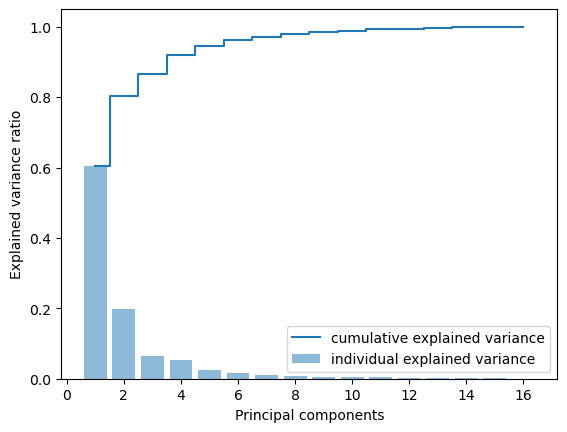

In [56]:
# we are plotting the a grpah with cum var and exp var 
plt.bar(range(1,17), var_explained, alpha=0.5, align='center', label='individual explained variance')
plt.step(range(1,17),cum_var_exp, where= 'mid', label='cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal components')
plt.legend(loc = 'best')
plt.show()

In [57]:
# now we are performing dimension reduction to 6 PC's i.e. 96% of data can be explained
pca_reduce=np.array(train_eigvectors_sorted[0:6])
pca_reduce


array([[ 0.27710147,  0.10165753, -0.0595415 , -0.15827411,  0.13460751,
        -0.73969235, -0.41934608, -0.31144754, -0.12886129, -0.00985262,
        -0.13186256, -0.04647793,  0.06914657, -0.0568805 , -0.04343307,
         0.00408269],
       [ 0.28927645, -0.12567944, -0.11544708,  0.1965377 , -0.43066989,
        -0.02300014, -0.02522537,  0.01107538,  0.18825467, -0.05249209,
         0.33932248, -0.64790298,  0.16137684, -0.19383336, -0.15834174,
        -0.00222559],
       [ 0.30289976,  0.06881344,  0.01319676,  0.05967857,  0.25576491,
         0.15871953,  0.27722446, -0.20855988, -0.31136725, -0.00487465,
         0.06674042,  0.05173777, -0.20171883, -0.12788964, -0.70309723,
         0.18255461],
       [ 0.26378179,  0.19516917,  0.15286829, -0.15293935, -0.07354198,
         0.50104831, -0.72413446,  0.01731396,  0.13554229,  0.01168021,
         0.02943882,  0.12932783, -0.02403781,  0.01997797, -0.09019995,
         0.13866235],
       [ 0.20123953,  0.14262032, -0

In [58]:


# projecting original data into principal component dimensions
X_std_6D = np.dot(x_train_std,pca_reduce.T)   
X_test_std_6D = np.dot(x_test_std,pca_reduce.T)
X_std_6D

array([[-0.37804656, -0.49924542, -0.1538844 ,  0.13444702,  0.81667196,
        -0.04939825],
       [ 0.46686956,  0.50891212,  0.01000553, -1.09884875, -0.19052218,
        -1.00490845],
       [ 0.28582891,  0.17647999, -0.07385091, -1.40989294, -0.97089036,
        -1.1794668 ],
       ...,
       [ 0.6584283 ,  0.4357967 ,  0.08624539, -0.99868329, -2.25944211,
        -0.61590384],
       [-0.45005584, -0.61370783,  1.02340874,  3.07984993,  3.02012802,
         2.35367968],
       [-0.73211426,  0.29967221, -0.5342799 ,  1.64505087,  1.38281296,
         1.00291087]])

In [59]:
# the data is in array format conveting it into a DF 
# here the indexs will be 0 1 2 ... and columsn will be 0 1 2 .. as we did not specify that 
# columns 0 1 2 .. indicate the PC1, PC2, ...
proj_train_data=pd.DataFrame(X_std_6D)
proj_test_data = pd.DataFrame(X_test_std_6D)

In [60]:
proj_train_data.head()

,0,1,2,3,4,5
0,-0.378047,-0.499245,-0.153884,0.134447,0.816672,-0.049398
1,0.466870,0.508912,0.010006,-1.098849,-0.190522,-1.004908
2,0.285829,0.176480,-0.073851,-1.409893,-0.970890,-1.179467
3,-0.372602,-0.767425,-0.287882,1.218035,1.693213,0.735096
4,-0.685933,-0.112453,0.565230,2.239000,1.690014,1.846309


In [61]:
# here we are indexing the projeted data with correct indexes
# this is done line by line no conditions are verified
# i.e. lets say the first index is 10 and 100th index is 1 in x_train then same thing will be there for the proj_train_data 
proj_train_data.index = x_train.index
proj_test_data.index = x_test.index

In [62]:
proj_train_data


,0,1,2,3,4,5
298,-0.378047,-0.499245,-0.153884,0.134447,0.816672,-0.049398
147,0.466870,0.508912,0.010006,-1.098849,-0.190522,-1.004908
312,0.285829,0.176480,-0.073851,-1.409893,-0.970890,-1.179467
443,-0.372602,-0.767425,-0.287882,1.218035,1.693213,0.735096
306,-0.685933,-0.112453,0.565230,2.239000,1.690014,1.846309
...,...,...,...,...,...,...
252,0.291285,-0.843356,0.419233,-0.720978,-0.860224,-0.652562
497,0.863587,-0.001600,0.705681,-0.409702,-0.752053,-0.071308
266,0.658428,0.435797,0.086245,-0.998683,-2.259442,-0.615904
44,-0.450056,-0.613708,1.023409,3.079850,3.020128,2.353680


## using PCA and projecting data points on to the PC and creating a model based on the PC

In [63]:
from sklearn import svm
clf=svm.SVC(gamma=0.025,C=3)

In [64]:
clf.fit(proj_train_data , y_train)

SVC(C=3, gamma=0.025)

In [65]:
y_pred = clf.predict(proj_test_data)

In [66]:
clf.score(proj_test_data, y_test)

0.84251968503937

In [67]:
pd.crosstab(y_test, y_pred)

col_0,bus,car,van
class,,,
bus,52,9,3
car,8,108,9
van,5,6,54


In [68]:
# precision is about being precise (minimizing false positives), ratio of correctly predicted positive observations to the total predicted
# recall is about capturing all relevant instances (minimizing false negatives), ratio of correctly predicted positive observations to all the actual positives.
# the F1-score is a balance between the two.
from sklearn.metrics import classification_report
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

         bus       0.80      0.81      0.81        64
         car       0.88      0.86      0.87       125
         van       0.82      0.83      0.82        65

    accuracy                           0.84       254
   macro avg       0.83      0.84      0.83       254
weighted avg       0.84      0.84      0.84       254



## using raw data for SVM

In [69]:
from sklearn import svm
clf=svm.SVC(gamma=0.025,C=3)
clf.fit(x_train , y_train)


SVC(C=3, gamma=0.025)

In [70]:
y_pred = clf.predict(x_test)


In [71]:
clf.score(x_test, y_test)

0.5393700787401575

In [72]:
from sklearn.metrics import classification_report
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

         bus       1.00      0.14      0.25        64
         car       0.52      1.00      0.68       125
         van       1.00      0.05      0.09        65

    accuracy                           0.54       254
   macro avg       0.84      0.40      0.34       254
weighted avg       0.76      0.54      0.42       254



In [73]:
#Model score with raw data is 55.5% while that with PCA components is 84.3%, 
#raw data had about 15 dimensions while PCA components uses only 5 dimensions.

# =========================================================

# using PCA model from sklearn

In [74]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
%matplotlib inline

In [75]:
# data_df is the processed data
dataset=data_df

In [76]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaled_df = scaler.fit_transform(dataset.drop(columns = 'class'))

In [77]:
X = scaled_df
y = dataset['class']

X_train, X_test, Y_train, Y_test = train_test_split(X,y, random_state = 10)

X_train.shape, X_test.shape, Y_train.shape, Y_test.shape

((634, 18), (212, 18), (634,), (212,))

In [78]:
# Training an SVC using the actual attributes(scaled)

model = SVC(gamma = 'auto')

model.fit(X_train,Y_train)

score_using_actual_attributes = model.score(X_test, Y_test)

print(score_using_actual_attributes)

0.9669811320754716


In [79]:
# using grid seach cv for getting better parameters
model = SVC()

params = {'C': [0.01, 0.1, 0.5, 1], 'kernel': ['linear', 'rbf'], 'gamma' : ['auto', 'scale' ]}

model1 = GridSearchCV(model, param_grid=params, verbose=5)

model1.fit(X_train, Y_train)

print("Best Hyper Parameters:\n", model1.best_params_)

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV 1/5] END .C=0.01, gamma=auto, kernel=linear;, score=0.866 total time=   0.0s
[CV 2/5] END .C=0.01, gamma=auto, kernel=linear;, score=0.874 total time=   0.0s
[CV 3/5] END .C=0.01, gamma=auto, kernel=linear;, score=0.858 total time=   0.0s
[CV 4/5] END .C=0.01, gamma=auto, kernel=linear;, score=0.906 total time=   0.0s
[CV 5/5] END .C=0.01, gamma=auto, kernel=linear;, score=0.833 total time=   0.0s
[CV 1/5] END ....C=0.01, gamma=auto, kernel=rbf;, score=0.504 total time=   0.0s
[CV 2/5] END ....C=0.01, gamma=auto, kernel=rbf;, score=0.504 total time=   0.0s
[CV 3/5] END ....C=0.01, gamma=auto, kernel=rbf;, score=0.496 total time=   0.0s
[CV 4/5] END ....C=0.01, gamma=auto, kernel=rbf;, score=0.496 total time=   0.0s
[CV 5/5] END ....C=0.01, gamma=auto, kernel=rbf;, score=0.500 total time=   0.0s
[CV 1/5] END C=0.01, gamma=scale, kernel=linear;, score=0.866 total time=   0.0s
[CV 2/5] END C=0.01, gamma=scale, kernel=linear;

In [80]:
model = SVC(C=1, kernel="rbf", gamma='auto')

In [81]:
# we are cross validating the model with mulitple train and test split
# cv=10 --> specifies the number of folds in the cross-validation. In this case, it's set to 10, meaning the data will be split into 10 folds, and the model will be trained and tested 10 times
scores = cross_val_score(model, X, y, cv=10)

CV_score = scores.mean()
CV_score

0.9598039215686273

## Let's create Principle Components out of the attributes by importing PCA

[0.54145147 0.72729151 0.79183161 0.85543284 0.90403946 0.94174249
 0.9596302  0.97239539 0.9797526  0.98420395 0.98824001 0.99180342
 0.99402619 0.9957684  0.99739246 0.99861465 0.99971765 1.        ]


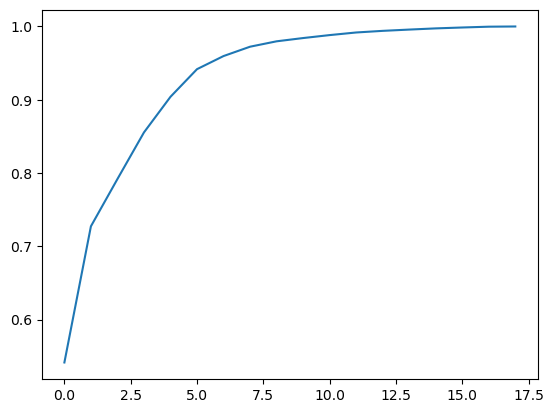

In [82]:
from sklearn.decomposition import PCA

pca=PCA()
# scaled_df is the scaled version of data without the class column i.e X
pca.fit(scaled_df)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
print(np.cumsum(pca.explained_variance_ratio_))

### Let's pick 8 PCs as the first 8 capture more than 95% of the variance in the data

In [83]:
pca=PCA(n_components=8)

# fitting the PCA model to your data and transforming/projecting the data on the principal components
# i.e finding the PC based on data and projecting data points on 8 PCs 
X = pca.fit_transform(scaled_df)
Y = dataset['class']

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, random_state=10)
X_train.shape, X_test.shape, Y_train.shape, Y_test.shape


((634, 8), (212, 8), (634,), (212,))

In [84]:
# Training an SVC using the PCs instead of the actual attributes 
model = SVC(gamma= 'auto')

model.fit(X_train,Y_train)

score_PCs = model.score(X_test, Y_test)

print(score_PCs)

0.9339622641509434


In [85]:
model = SVC()

params = {'C': [0.01, 0.1, 0.5, 1], 'kernel': ['linear', 'rbf'], 'gamma' : ['auto', 'scale' ]}

model1 = GridSearchCV(model, param_grid=params, verbose=5)

model1.fit(X_train, Y_train)

print("Best Hyper Parameters:\n", model1.best_params_)

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV 1/5] END .C=0.01, gamma=auto, kernel=linear;, score=0.843 total time=   0.0s
[CV 2/5] END .C=0.01, gamma=auto, kernel=linear;, score=0.858 total time=   0.0s
[CV 3/5] END .C=0.01, gamma=auto, kernel=linear;, score=0.866 total time=   0.0s
[CV 4/5] END .C=0.01, gamma=auto, kernel=linear;, score=0.882 total time=   0.0s
[CV 5/5] END .C=0.01, gamma=auto, kernel=linear;, score=0.817 total time=   0.0s
[CV 1/5] END ....C=0.01, gamma=auto, kernel=rbf;, score=0.504 total time=   0.0s
[CV 2/5] END ....C=0.01, gamma=auto, kernel=rbf;, score=0.504 total time=   0.0s
[CV 3/5] END ....C=0.01, gamma=auto, kernel=rbf;, score=0.496 total time=   0.0s
[CV 4/5] END ....C=0.01, gamma=auto, kernel=rbf;, score=0.496 total time=   0.0s
[CV 5/5] END ....C=0.01, gamma=auto, kernel=rbf;, score=0.500 total time=   0.0s
[CV 1/5] END C=0.01, gamma=scale, kernel=linear;, score=0.843 total time=   0.0s
[CV 2/5] END C=0.01, gamma=scale, kernel=linear;

In [86]:
# cross validating
model = SVC(C=1, kernel="rbf", gamma='auto')

scores = cross_val_score(model, X, y, cv=10)

CV_score_pca = scores.mean()
print(CV_score_pca)

0.9527030812324929


## Result

In [87]:
result = pd.DataFrame({
                        'SVC' : ['All scaled attributes', '8 Principle components'],
    
                        'Accuracy' : [score_using_actual_attributes, score_PCs],
    
                        'Cross-validation score' : [CV_score, CV_score_pca]})

In [88]:
result

,SVC,Accuracy,Cross-validation score
0,All scaled attributes,0.966981,0.959804
1,8 Principle components,0.933962,0.952703


## What was achieved using 18 attributes has been achieved using just 8 principle components. yay!